<a href="https://colab.research.google.com/github/luanvu2307/UIT-Project/blob/master/Classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2
import torch.nn as nn
from torch.nn import Conv2d, functional as F, Linear, MaxPool2d, Module
import torchvision.models as models
from torchvision.io import read_image
import os
import pandas as pd
from torch.utils.data import Dataset, DataLoader ,random_split
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch.optim as optim
from torch.optim import lr_scheduler
import torch
import time,copy
from torch.utils.tensorboard import SummaryWriter
import tensorflow as tf
from tqdm import tqdm
import pickle
from torchvision import transforms
from sklearn.utils import class_weight
from imgaug import augmenters as iaa
from sklearn.metrics import confusion_matrix
import itertools
import matplotlib.image as img
from sklearn.model_selection import train_test_split

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !unzip '/content/drive/MyDrive/food project/Luân/final_dataset.zip'

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/food project/Luân/dataset.csv',index_col =0)
df

,Name,class_name,class_number,label_name,label
0,class_54_img_23_0.jpg,Cream of Mushroom,54,Cream of Mushroom,2
1,class_84_img_60_0.jpg,galettes aux carottes vegan,84,galette,18
2,class_47_img_19_0.jpg,Heidelbeeren Tk,47,Heidelbeeren,4
3,class_91_img_21_1.jpg,Soto Madura,91,Soto,12
4,class_30_img_23_0.jpg,"Falafel ""oriental""",30,falafel,16
...,...,...,...,...,...
1579,class_91_img_44_0.jpg,Soto Madura,91,Soto,12
1580,class_49_img_27_1.jpg,bumbu soto ayam,49,Soto,12
1581,class_21_img_70_1.jpg,Rasa Soto Mie,21,Soto,12
1582,class_65_img_17_0.jpg,mi goreng rasa soto,65,fried noodle,17


In [ ]:
# name = os.listdir('/content/images')
# class_name = []
# class_number = []
# label = []
# label_name = []

In [ ]:
dictionary = {
    "Soto": ['0','14','21','33','49','50','53','55','58','60','70','75','76','77','83','91','95','96'],
    "Snack tofu": '1',
    "Frühlingsrollen": ['6','20','25','27','28','29','34','41','79'],
    'Oatmeal': ['8','9'],
    "Nuggets": '10',
    'Aceite de Oliva virgen extra': '19',
    'polvorones de grajea': '23',
    'Tomaten-Käse Tasche "Toskana"': '26',
    'falafel': ['30','64','86'],
    'mazapan': ['31','82','74'],
    'burger': ['35','78'],
    'Bio Samosas': '37',
    'Stelline Di Verdure':'42',
    'yogurt': '43',
    'Heidelbeeren ':'47',
    'Cream of Mushroom':'54',
    'Shrimp, Soto, Red Dragon, Brown Rice':'56',
    'Sorbete':'61',
    'Kruiden':'63',
    'fried noodle':['65','72','93','94','16','18'],
    'vegan pizza': '66',
    'Polpettine Vegetariane Alla Mediterranea':'69',
    'galette':['90','84']
}
dictionary

{'Aceite de Oliva virgen extra': '19',
 'Bio Samosas': '37',
 'Cream of Mushroom': '54',
 'Frühlingsrollen': ['6', '20', '25', '27', '28', '29', '34', '41', '79'],
 'Heidelbeeren ': '47',
 'Kruiden': '63',
 'Nuggets': '10',
 'Oatmeal': ['8', '9'],
 'Polpettine Vegetariane Alla Mediterranea': '69',
 'Shrimp, Soto, Red Dragon, Brown Rice': '56',
 'Snack tofu': '1',
 'Sorbete': '61',
 'Soto': ['0',
  '14',
  '21',
  '33',
  '49',
  '50',
  '53',
  '55',
  '58',
  '60',
  '70',
  '75',
  '76',
  '77',
  '83',
  '91',
  '95',
  '96'],
 'Stelline Di Verdure': '42',
 'Tomaten-Käse Tasche "Toskana"': '26',
 'burger': ['35', '78'],
 'falafel': ['30', '64', '86'],
 'fried noodle': ['65', '72', '93', '94', '16', '18'],
 'galette': ['90', '84'],
 'mazapan': ['31', '82', '74'],
 'polvorones de grajea': '23',
 'vegan pizza': '66',
 'yogurt': '43'}

In [ ]:
# for i in name:
#   class_name.append(df['food name'][int(i.split('_')[1])])
#   class_number.append(i.split('_')[1])

In [ ]:
# for i in class_number:
#   count = 0
#   for y in dictionary.values():
#     if type(y)== list and i in y:
#       label_name.append(list(dictionary.keys())[list(dictionary.values()).index(y)])
#     elif type(y) == str and i == y:
#       label_name.append(list(dictionary.keys())[list(dictionary.values()).index(y)])

In [ ]:
# data = pd.DataFrame({'Name':name,'class_name':class_name,'class_number':class_number,'label_name':label_name})

In [ ]:
# data['label_name']=data['label_name'].astype('category')
# data['label']=data['label_name'].cat.codes

In [ ]:
# data.to_csv('/content/drive/MyDrive/food project/Luân/dataset.csv')

In [ ]:
num_classes = df.label.nunique()
num_classes

23

In [ ]:
torch.manual_seed(42)

In [ ]:
torch.cuda.is_available()

True

In [ ]:
class MyDataset(Dataset):
  def __init__(self , csv_file , img_dir , transforms=None ):
    
    self.df = pd.read_csv(csv_file,index_col=0)
    self.img_dir = img_dir
    self.transforms = transforms
    
  def __getitem__(self,idx):
    d = self.df.iloc[idx]
    image = Image.open(self.img_dir + d.Name)
    label = d.label
    if self.transforms is not None:
      image = self.transforms(image)
    return image, torch.from_numpy(np.array(label))
  
  def __len__(self):
    return len(self.df)

In [ ]:
transform = transforms.Compose([
    # resize
    transforms.Resize(300),
    # # center-crop
    transforms.CenterCrop(224),
    # # transforms.RandomHorizontalFlip(),
    # # to-tensor
    transforms.ToTensor(),
    # normalize
    transforms.Normalize([0.485, 0.456, 0.406], 
                             [0.229, 0.224, 0.225])
])

In [ ]:
dataset = MyDataset("/content/drive/MyDrive/food project/Luân/dataset.csv", "/content/images/" , transforms=transform)
print(len(dataset))
labels = []
for data,label in dataset:
  labels.append(int(label))
valid_no = int(len(dataset)*0.15) 
# # trainset ,valset  = random_split( dataset , [len(dataset) -valid_no  ,valid_no])
train_idx, valid_idx= train_test_split(np.arange(len(labels)),test_size=0.15,shuffle=True,stratify=labels)
trainset = torch.utils.data.SubsetRandomSampler(train_idx)
valset = torch.utils.data.SubsetRandomSampler(valid_idx)
print(f"trainset len {len(trainset)} valset len {len(valset)}")
dataloader = {"train":DataLoader(dataset,sampler=trainset , batch_size=4),
              "valid": DataLoader(dataset,sampler=valset , batch_size=1)}

1584
trainset len 1346 valset len 238


In [ ]:
# temp = []
# for data,label in dataloader['train']:
#   temp.extend(label.numpy())
# temp2 = []
# for data,label in dataloader['valid']:
#   temp2.extend(label.numpy())

In [ ]:
# for i in np.arange(23):
#   print(temp.count(i),'\t',temp2.count(i))

In [ ]:
dataset_sizes = {
    'train':len(trainset),
    'valid':len(valset)}

In [ ]:
model = models.resnet101(pretrained=True)

Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth


  0%|          | 0.00/171M [00:00<?, ?B/s]

In [ ]:
model.fc = nn.Linear(in_features=2048, out_features=num_classes, bias=True)

In [ ]:
total_params = sum(p.numel() for p in model.parameters())
print(f'{total_params:,} total parameters.')
total_trainable_params = sum(
    p.numel() for p in model.parameters() if p.requires_grad)
print(f'{total_trainable_params:,} training parameters.')

42,547,287 total parameters.
42,547,287 training parameters.


In [ ]:
model.eval

<bound method Module.eval of ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, ke

In [ ]:
epochs = 70
learning_rate = 0.001

In [ ]:
class_weights = class_weight.compute_class_weight('balanced', df.label.unique(), np.array(df.label.tolist()))
class_weights=torch.tensor(class_weights,dtype=torch.float).cuda()

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)
criterion = nn.CrossEntropyLoss(weight=class_weights,reduction='mean')
optimizer = torch.optim.Adam(model.parameters(),lr = learning_rate)

In [ ]:
# # # # keeping-track-of-losses 
train_losses = []
valid_losses = []
val_accuracy = []

for epoch in range(1, epochs+1):
    # keep-track-of-training-and-validation-loss
    train_loss = 0.0
    valid_loss = 0.0
    
    # training-the-model
    model.train()
    for data, target in dataloader['train']:
        # move-tensors-to-GPU 
        data = data.to(device)
        target = target.to(device)
        
        # clear-the-gradients-of-all-optimized-variables
        optimizer.zero_grad()
        # forward-pass: compute-predicted-outputs-by-passing-inputs-to-the-model
        output = model(data)
        # calculate-the-batch-loss
        loss = criterion(output, target)
        # backward-pass: compute-gradient-of-the-loss-wrt-model-parameters
        loss.backward()
        # perform-a-ingle-optimization-step (parameter-update)
        optimizer.step()
        # update-training-loss
        train_loss += loss.item() * data.size(0)
        
    # validate-the-model
    model.eval()
    correct = 0
    total = 0
    for data, target in dataloader['valid']:
        
        data = data.to(device)
        target = target.to(device)
        
        output = model(data)
        
        loss = criterion(output, target)
        _, predicted = torch.max(output.data, 1)
        total += target.size(0)
        correct += (predicted == target).sum().item()
        
        # update-average-validation-loss 
        valid_loss += loss.item() * data.size(0)
    accuracy = 100 * correct / total
    val_accuracy.append(accuracy)
    # calculate-average-losses
    train_loss = train_loss/len(trainset)
    valid_loss = valid_loss/len(valset)
    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
        
    # print-training/validation-statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f} \tVal_Accuracy: {:.6f}'.format(
        epoch, train_loss, valid_loss, accuracy))

In [ ]:
torch.save(model.state_dict(), '/content/drive/MyDrive/food project/Luân/best.pt')

In [ ]:
model.load_state_dict(torch.load('/content/drive/MyDrive/food project/Luân/best.pt'))

<All keys matched successfully>

Text(0.5, 1.0, 'training loss')

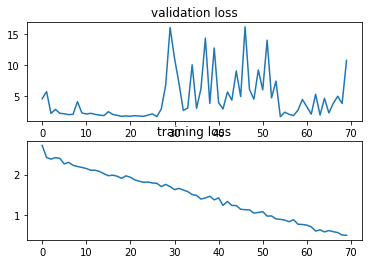

In [ ]:
fig, axs = plt.subplots(2)
axs[0].set_title('validation loss')
axs[0].plot(np.array(valid_losses))

axs[1].plot(np.array(train_losses))
axs[1].set_title('training loss')

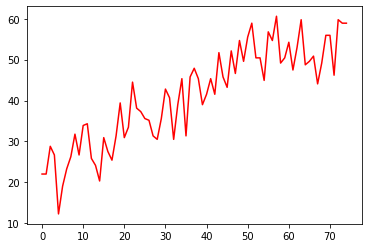

In [ ]:
plt.plot(np.array(val_accuracy), 'r')

In [ ]:
gt = []
pre = []

In [ ]:
model.eval()  # it-disables-dropout
with torch.no_grad():
    for images, labels in dataloader['valid']:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        gt.extend(labels.tolist())
        pre.extend(predicted.tolist())
          

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [ ]:
cm = confusion_matrix(gt,pre)
classes = sorted(list(set(df.label_name.tolist())))

In [ ]:
def plot_confusion_matrix(cm, classes, normalize=True, title='Confusion Matrix',export_as='confusion_matrix', cmap=plt.cm.Blues):
    plt.figure(figsize=(20,20))
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=16)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True labels', fontsize=14)
    plt.xlabel('Predicted labels', fontsize=14)


Normalized confusion matrix


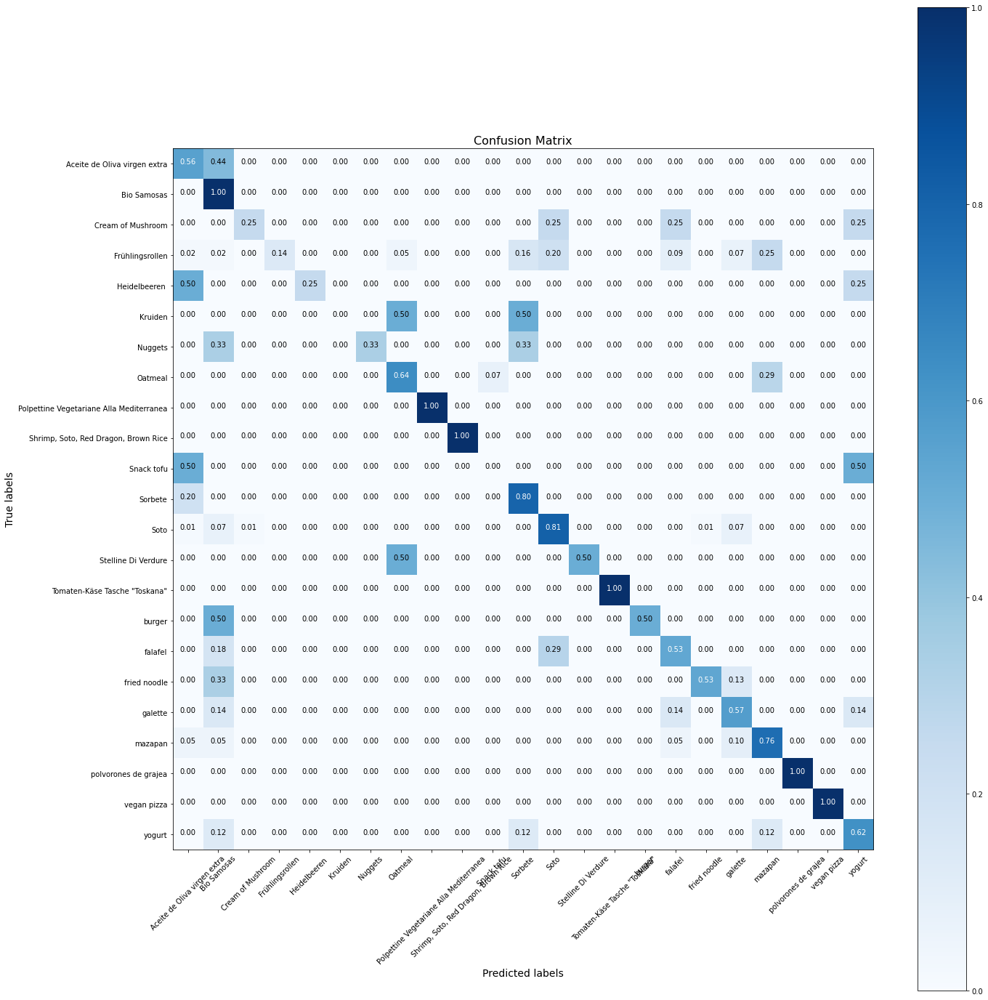

In [ ]:
plot_confusion_matrix(cm,classes)

In [ ]:
fig,ax = plt.subplots(1,5,figsize = (15,3))
for i,idx in enumerate(df.Name.tolist()[:5]):
    path = os.path.join('/content/images',idx)  
    ax[i].set_title(df.label_name[i])
    ax[i].imshow(img.imread(path))
plt.show()

In [ ]:
std = [0.485, 0.456, 0.406]
mean = [0.229, 0.224, 0.225]

gt:  mazapan
predict:  mazapan


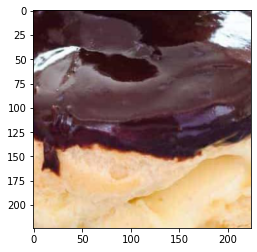

gt:  mazapan
predict:  mazapan


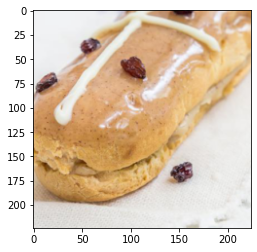

gt:  fried noodle
predict:  galette


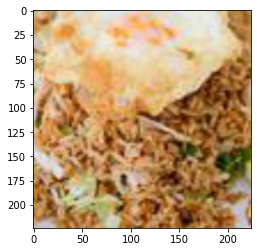

gt:  Heidelbeeren 
predict:  Heidelbeeren 


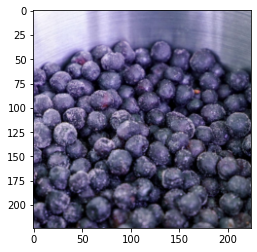

gt:  Frühlingsrollen
predict:  Soto


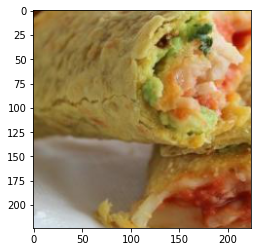

gt:  Aceite de Oliva virgen extra
predict:  Aceite de Oliva virgen extra


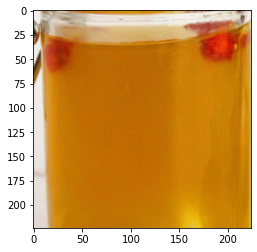

gt:  Frühlingsrollen
predict:  Frühlingsrollen


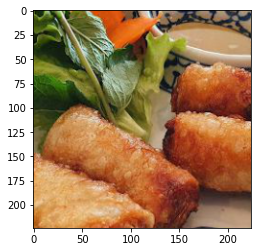

gt:  Frühlingsrollen
predict:  Sorbete


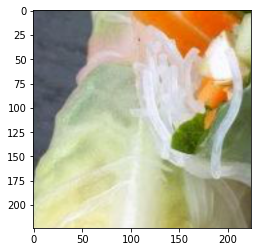

gt:  falafel
predict:  falafel


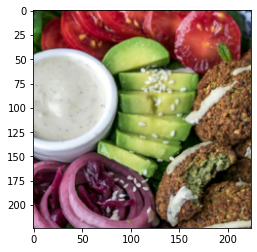

gt:  Oatmeal
predict:  Oatmeal


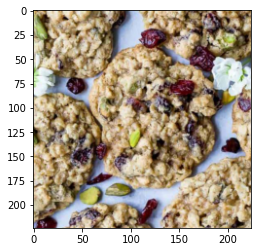

gt:  Soto
predict:  Soto


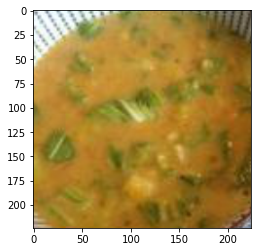

gt:  falafel
predict:  Sorbete


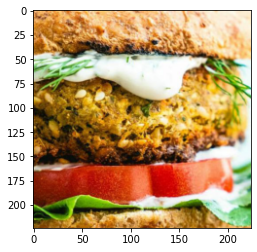

gt:  Oatmeal
predict:  Oatmeal


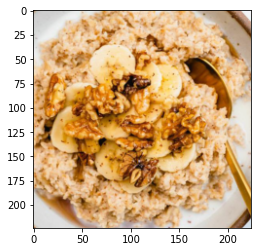

gt:  falafel
predict:  Soto


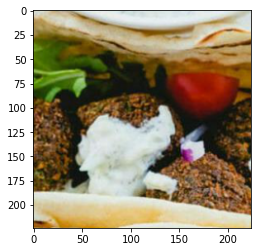

gt:  Soto
predict:  Soto


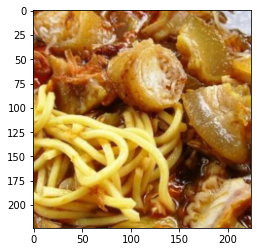

gt:  fried noodle
predict:  Bio Samosas


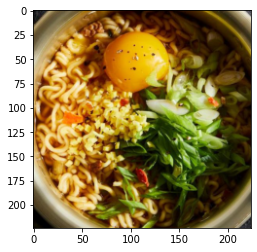

gt:  Frühlingsrollen
predict:  mazapan


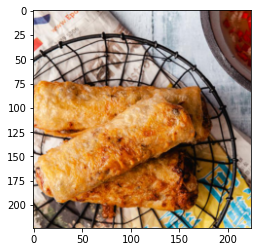

gt:  galette
predict:  galette


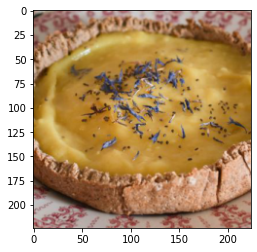

gt:  fried noodle
predict:  Bio Samosas


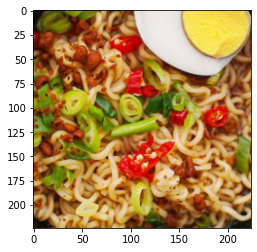

gt:  Soto
predict:  Soto


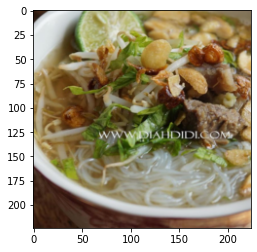

gt:  Frühlingsrollen
predict:  galette


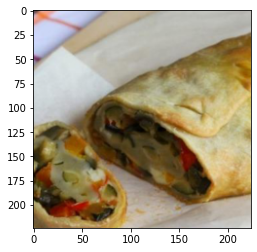

gt:  Aceite de Oliva virgen extra
predict:  Aceite de Oliva virgen extra


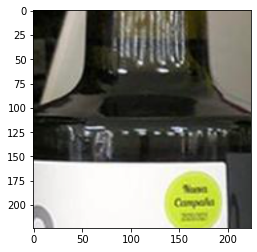

gt:  Soto
predict:  Soto


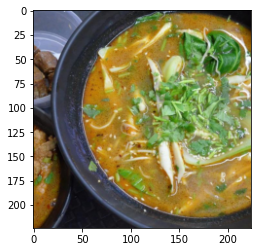

gt:  falafel
predict:  Bio Samosas


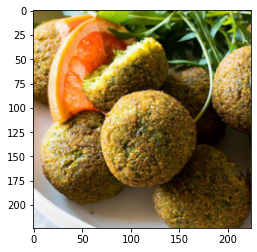

gt:  Frühlingsrollen
predict:  Frühlingsrollen


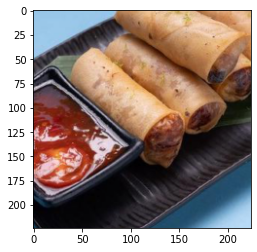

gt:  galette
predict:  galette


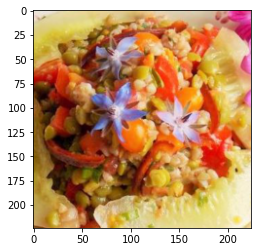

gt:  Frühlingsrollen
predict:  falafel


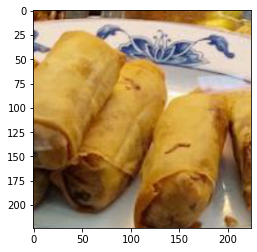

gt:  mazapan
predict:  Nuggets


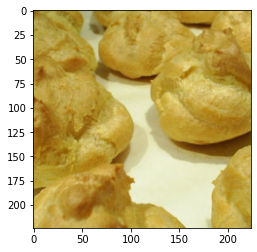

gt:  falafel
predict:  Aceite de Oliva virgen extra


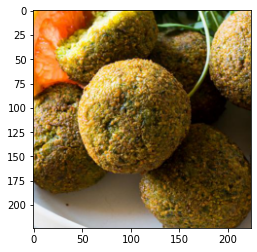

gt:  Frühlingsrollen
predict:  galette


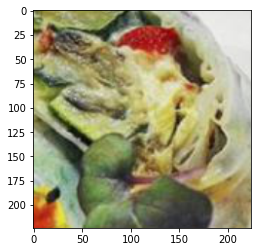

gt:  mazapan
predict:  mazapan


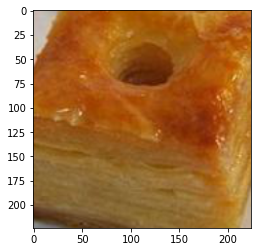

gt:  galette
predict:  galette


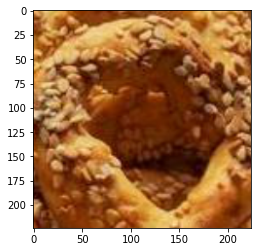

gt:  Soto
predict:  Soto


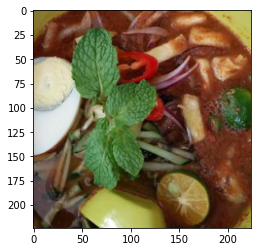

gt:  mazapan
predict:  mazapan


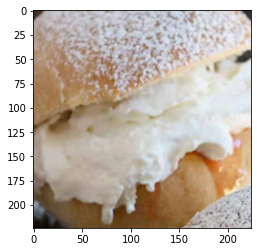

gt:  mazapan
predict:  mazapan


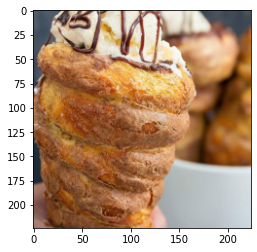

gt:  Soto
predict:  Soto


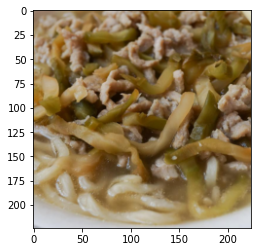

gt:  mazapan
predict:  mazapan


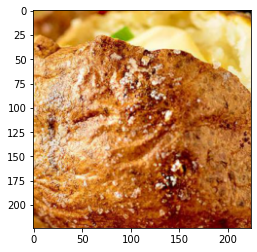

gt:  fried noodle
predict:  fried noodle


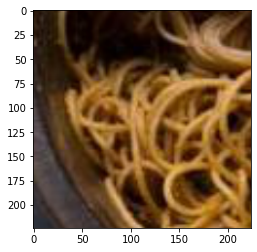

gt:  Soto
predict:  Soto


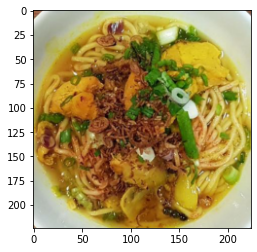

gt:  Soto
predict:  Soto


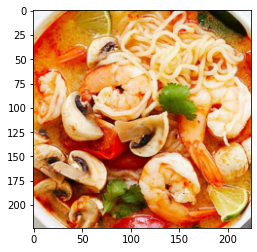

gt:  Soto
predict:  Soto


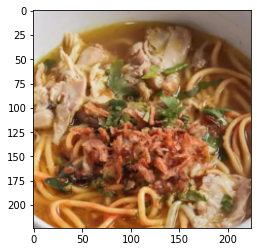

gt:  Soto
predict:  Soto


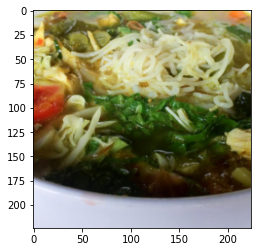

gt:  falafel
predict:  falafel


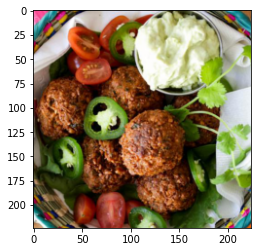

gt:  Soto
predict:  Soto


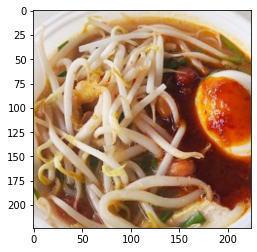

gt:  Oatmeal
predict:  Oatmeal


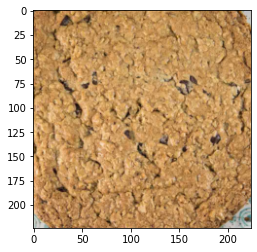

gt:  yogurt
predict:  Oatmeal


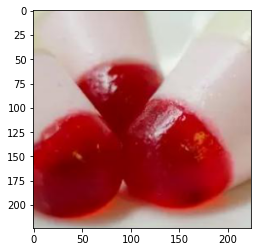

gt:  mazapan
predict:  mazapan


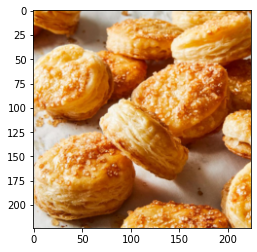

gt:  Soto
predict:  galette


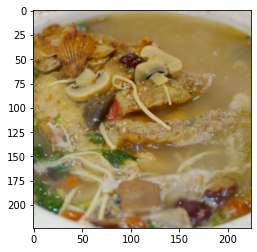

gt:  Bio Samosas
predict:  Bio Samosas


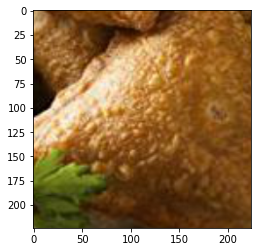

gt:  Soto
predict:  Soto


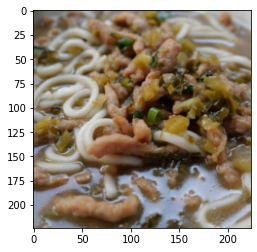

gt:  Frühlingsrollen
predict:  falafel


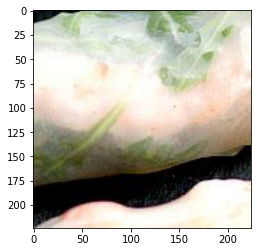

gt:  falafel
predict:  falafel


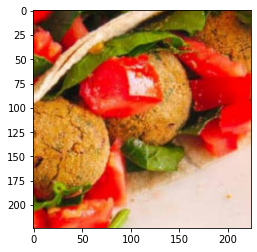

gt:  Soto
predict:  Soto


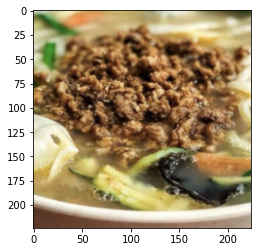

gt:  Sorbete
predict:  Sorbete


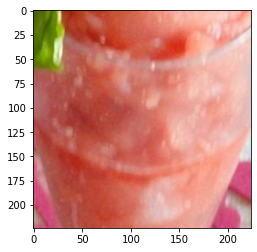

gt:  fried noodle
predict:  Bio Samosas


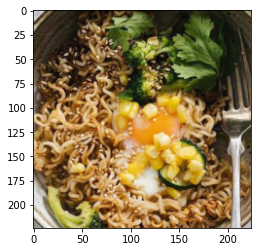

gt:  mazapan
predict:  galette


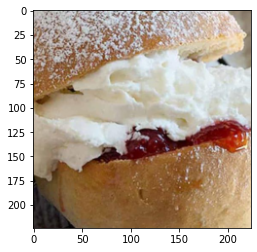

gt:  Soto
predict:  Soto


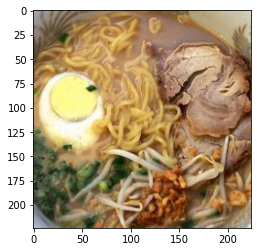

gt:  falafel
predict:  falafel


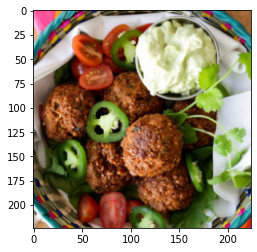

gt:  mazapan
predict:  Bio Samosas


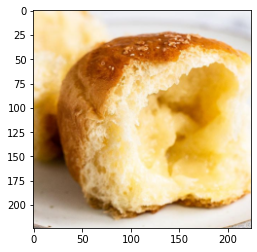

gt:  Heidelbeeren 
predict:  Aceite de Oliva virgen extra


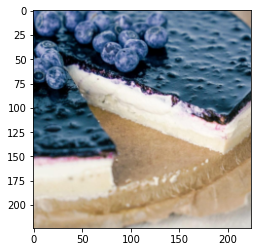

gt:  Oatmeal
predict:  Oatmeal


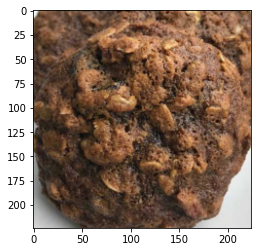

gt:  Sorbete
predict:  Sorbete


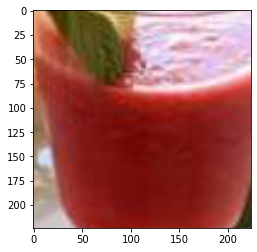

gt:  Soto
predict:  Soto


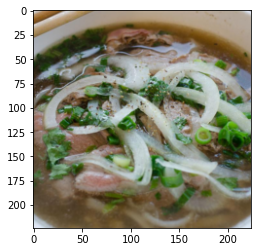

gt:  Frühlingsrollen
predict:  Soto


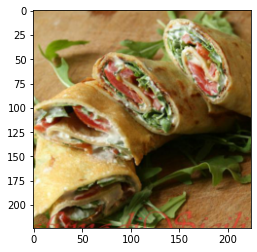

gt:  Frühlingsrollen
predict:  mazapan


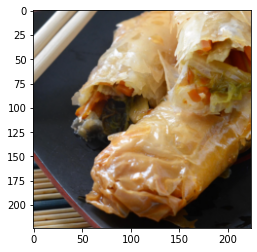

gt:  Soto
predict:  Soto


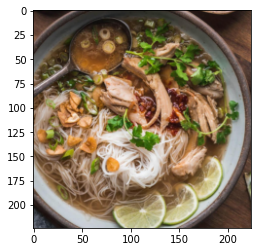

gt:  Soto
predict:  Soto


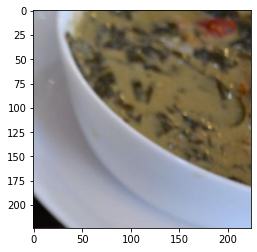

gt:  Soto
predict:  Soto


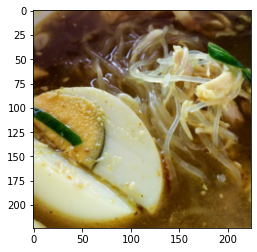

gt:  Soto
predict:  galette


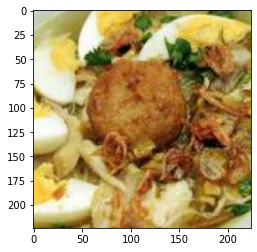

gt:  Soto
predict:  Soto


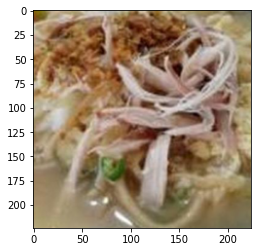

gt:  Soto
predict:  Soto


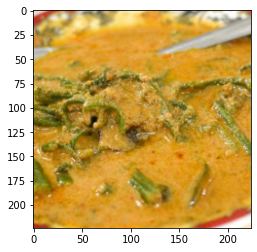

gt:  Frühlingsrollen
predict:  falafel


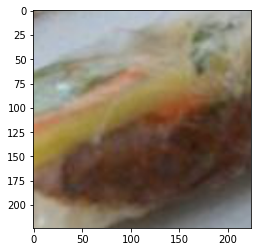

gt:  Heidelbeeren 
predict:  mazapan


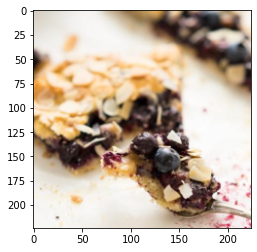

gt:  Soto
predict:  Bio Samosas


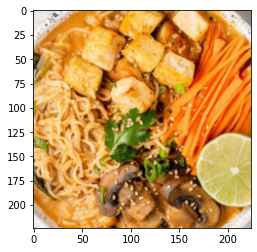

gt:  mazapan
predict:  mazapan


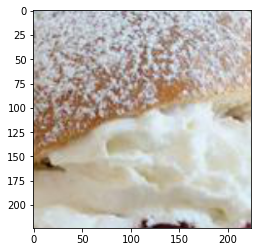

gt:  Oatmeal
predict:  Oatmeal


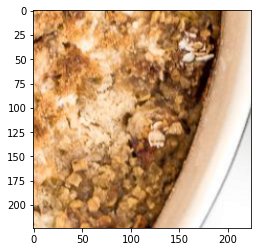

gt:  Stelline Di Verdure
predict:  Stelline Di Verdure


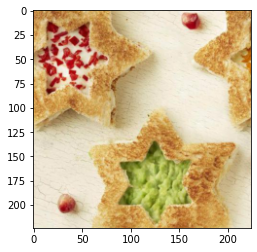

gt:  Soto
predict:  Soto


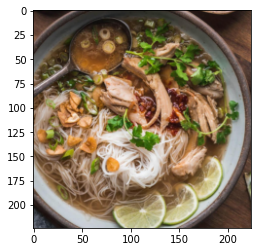

gt:  Soto
predict:  Bio Samosas


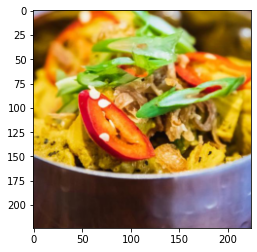

gt:  Tomaten-Käse Tasche "Toskana"
predict:  Tomaten-Käse Tasche "Toskana"


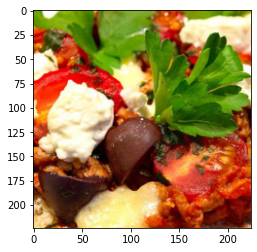

gt:  Soto
predict:  fried noodle


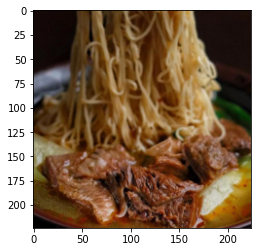

gt:  Frühlingsrollen
predict:  Frühlingsrollen


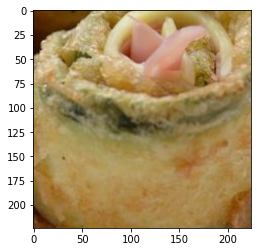

gt:  mazapan
predict:  mazapan


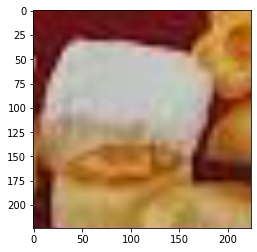

gt:  Aceite de Oliva virgen extra
predict:  Soto


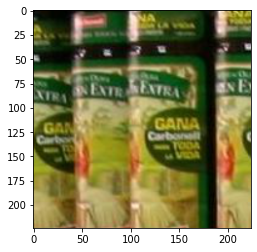

gt:  Oatmeal
predict:  Oatmeal


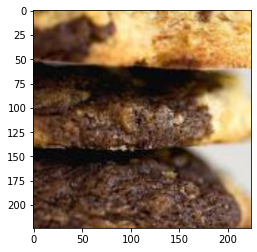

gt:  Frühlingsrollen
predict:  Frühlingsrollen


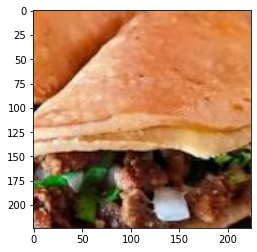

gt:  Soto
predict:  Soto


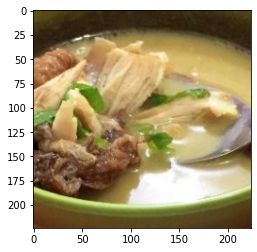

gt:  Frühlingsrollen
predict:  Frühlingsrollen


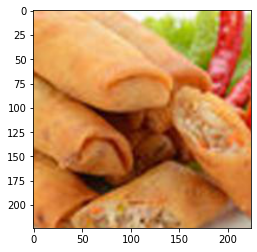

gt:  falafel
predict:  falafel


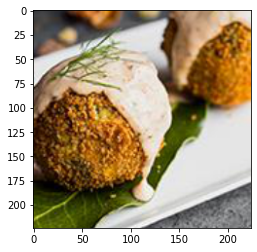

gt:  Stelline Di Verdure
predict:  mazapan


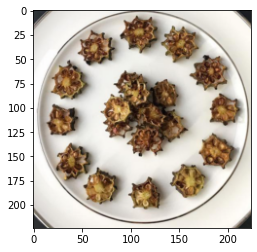

gt:  Nuggets
predict:  Frühlingsrollen


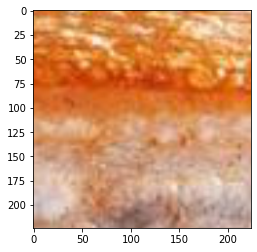

gt:  Soto
predict:  Soto


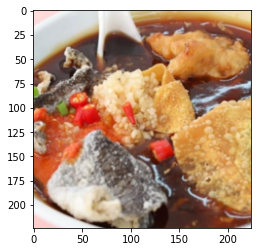

gt:  Sorbete
predict:  Bio Samosas


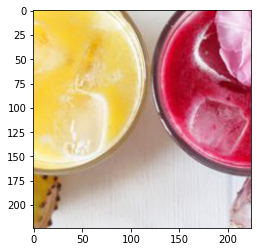

gt:  Aceite de Oliva virgen extra
predict:  Bio Samosas


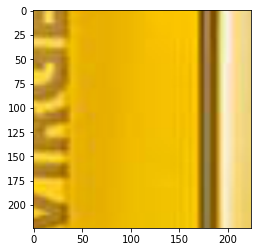

gt:  Cream of Mushroom
predict:  Soto


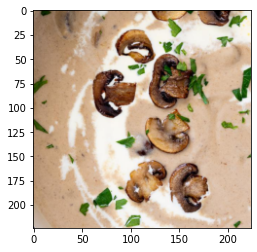

gt:  Soto
predict:  Bio Samosas


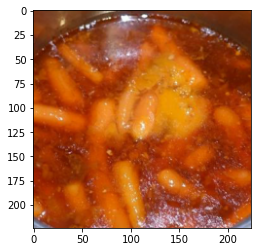

gt:  Soto
predict:  galette


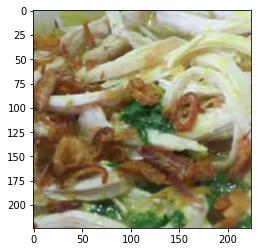

gt:  Soto
predict:  mazapan


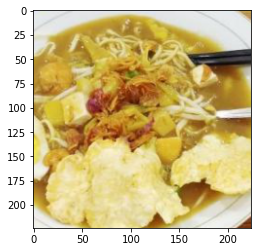

gt:  Soto
predict:  Soto


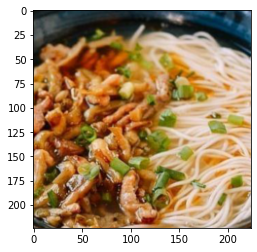

gt:  Oatmeal
predict:  Oatmeal


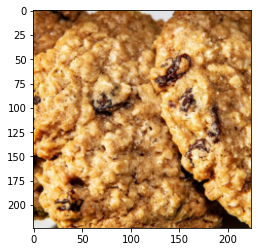

gt:  Soto
predict:  Soto


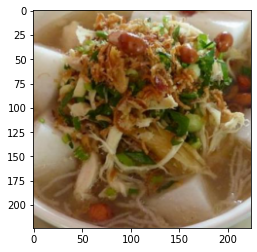

gt:  Soto
predict:  Soto


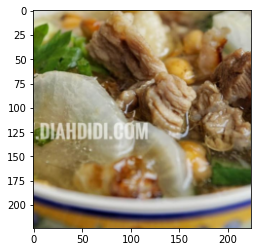

gt:  Soto
predict:  Bio Samosas


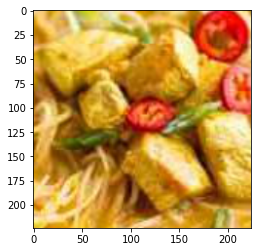

gt:  Soto
predict:  Bio Samosas


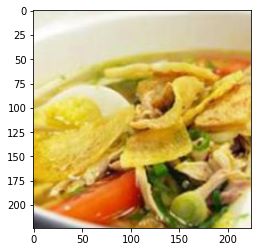

gt:  Sorbete
predict:  Sorbete


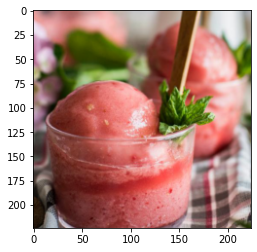

gt:  Soto
predict:  Oatmeal


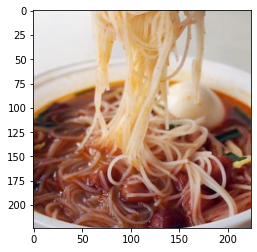

gt:  Frühlingsrollen
predict:  Soto


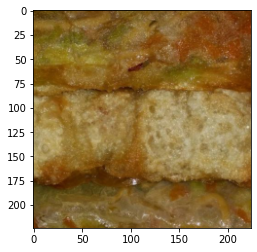

gt:  burger
predict:  burger


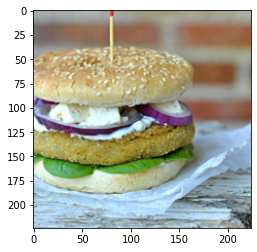

gt:  Nuggets
predict:  Heidelbeeren 


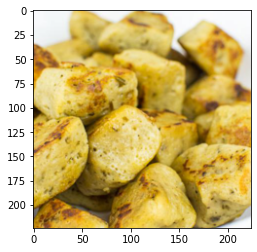

gt:  Frühlingsrollen
predict:  Frühlingsrollen


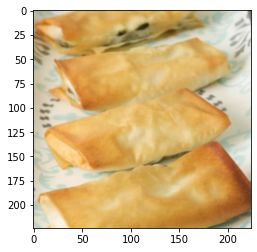

gt:  galette
predict:  galette


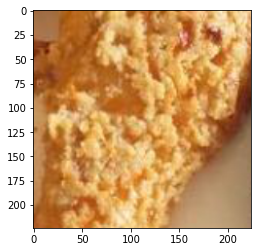

gt:  fried noodle
predict:  fried noodle


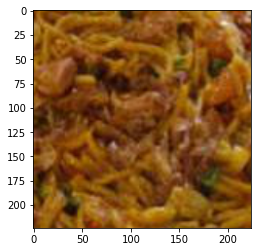

gt:  Oatmeal
predict:  Oatmeal


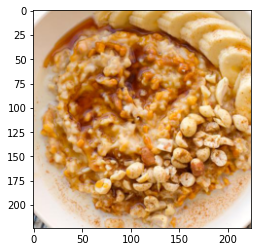

gt:  Aceite de Oliva virgen extra
predict:  Bio Samosas


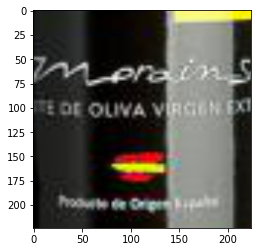

gt:  yogurt
predict:  Sorbete


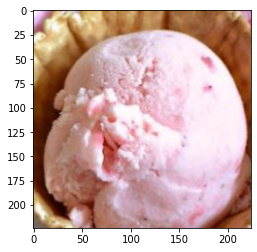

gt:  Soto
predict:  Soto


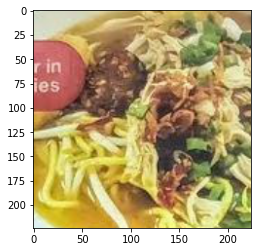

gt:  falafel
predict:  Bio Samosas


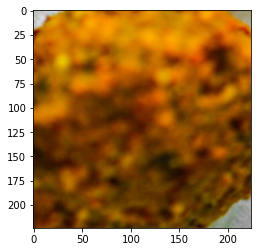

gt:  Soto
predict:  Soto


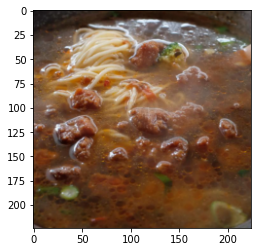

gt:  Oatmeal
predict:  Oatmeal


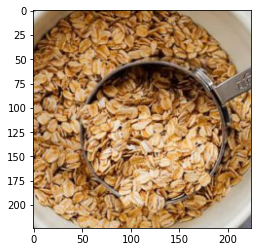

gt:  Snack tofu
predict:  Bio Samosas


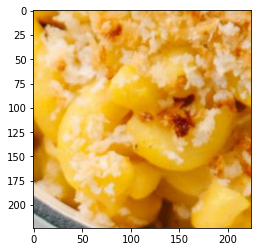

gt:  mazapan
predict:  mazapan


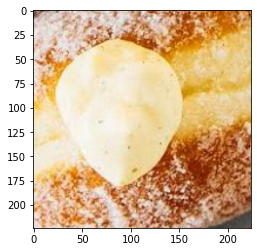

gt:  Frühlingsrollen
predict:  Soto


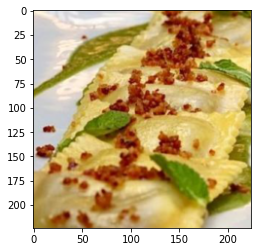

gt:  polvorones de grajea
predict:  polvorones de grajea


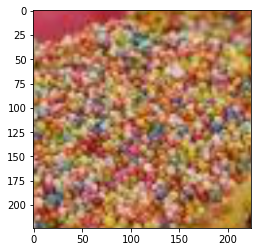

gt:  Frühlingsrollen
predict:  Bio Samosas


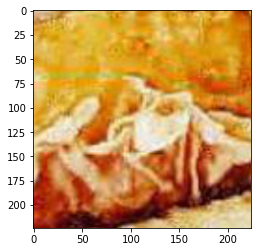

gt:  mazapan
predict:  galette


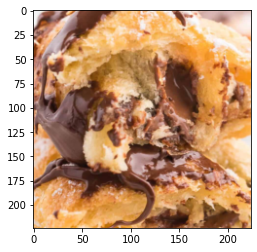

gt:  galette
predict:  galette


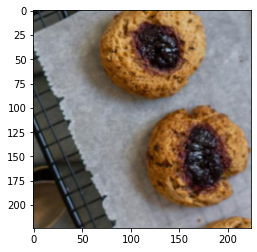

gt:  Soto
predict:  Soto


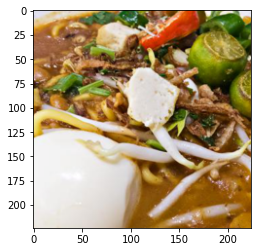

gt:  Soto
predict:  fried noodle


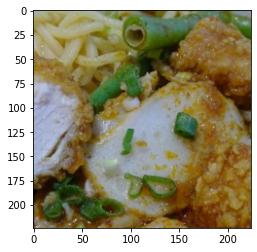

gt:  Frühlingsrollen
predict:  galette


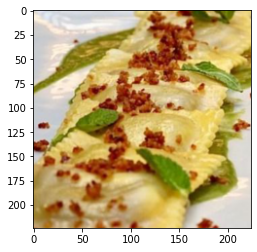

gt:  Oatmeal
predict:  Oatmeal


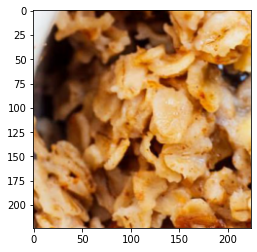

gt:  vegan pizza
predict:  vegan pizza


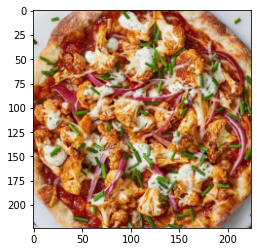

gt:  mazapan
predict:  mazapan


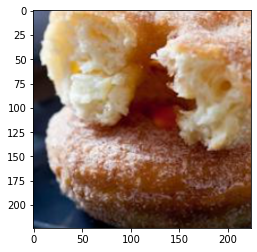

gt:  Heidelbeeren 
predict:  Heidelbeeren 


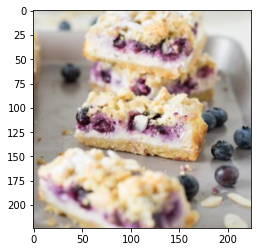

gt:  Soto
predict:  Bio Samosas


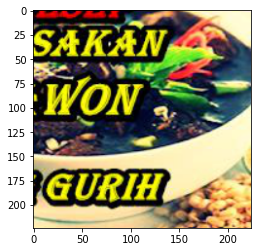

gt:  Frühlingsrollen
predict:  Bio Samosas


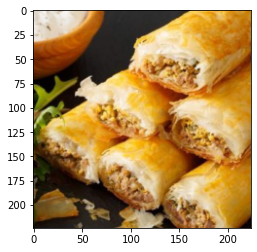

gt:  Frühlingsrollen
predict:  Bio Samosas


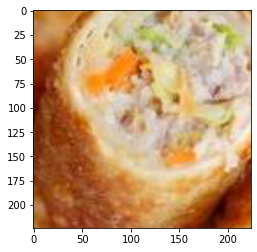

gt:  Frühlingsrollen
predict:  Frühlingsrollen


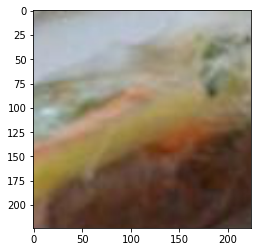

gt:  falafel
predict:  falafel


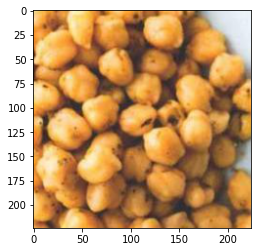

gt:  polvorones de grajea
predict:  polvorones de grajea


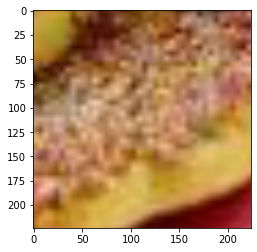

gt:  fried noodle
predict:  Bio Samosas


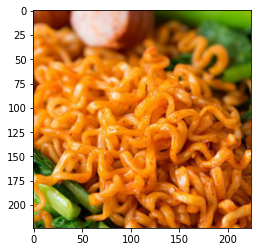

gt:  Kruiden
predict:  Kruiden


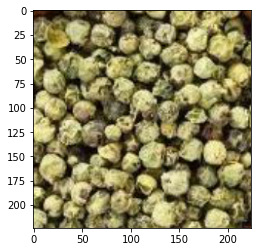

gt:  yogurt
predict:  Sorbete


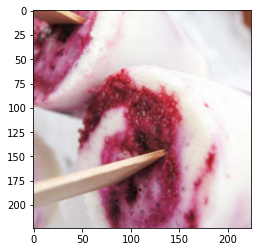

gt:  Soto
predict:  fried noodle


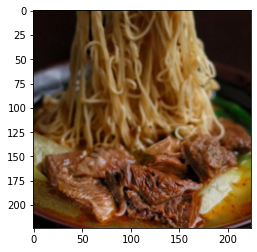

gt:  Soto
predict:  Soto


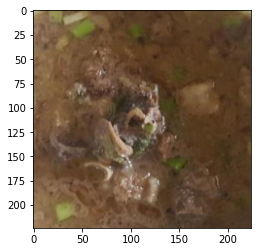

gt:  Frühlingsrollen
predict:  Frühlingsrollen


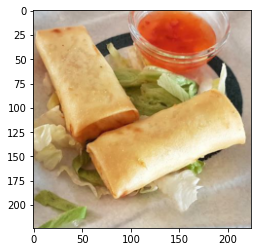

gt:  fried noodle
predict:  fried noodle


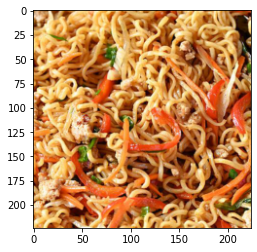

gt:  Soto
predict:  Soto


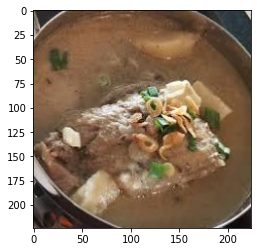

gt:  fried noodle
predict:  fried noodle


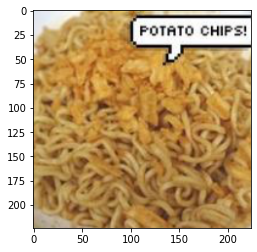

gt:  Frühlingsrollen
predict:  Soto


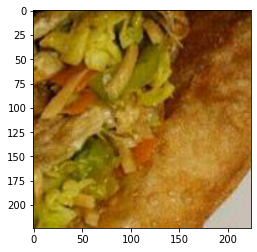

gt:  Soto
predict:  Soto


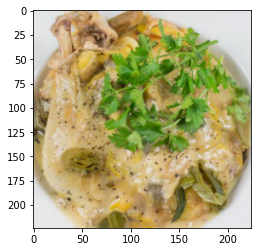

gt:  Frühlingsrollen
predict:  Frühlingsrollen


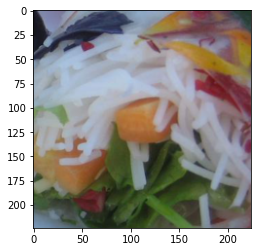

gt:  Soto
predict:  Sorbete


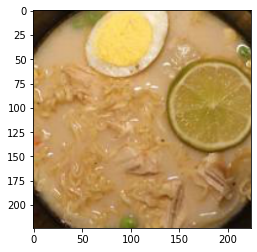

gt:  falafel
predict:  falafel


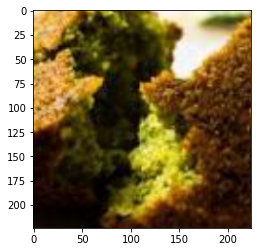

gt:  mazapan
predict:  mazapan


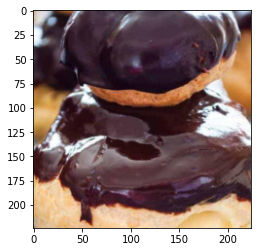

gt:  Soto
predict:  Soto


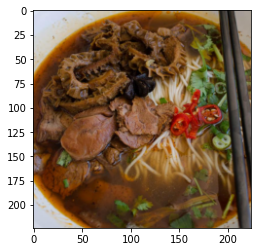

gt:  Soto
predict:  Soto


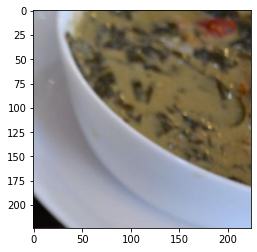

gt:  Soto
predict:  falafel


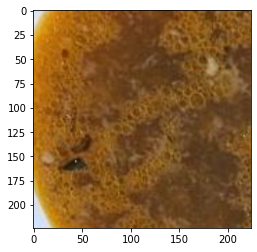

gt:  Frühlingsrollen
predict:  mazapan


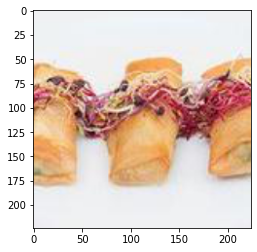

gt:  galette
predict:  yogurt


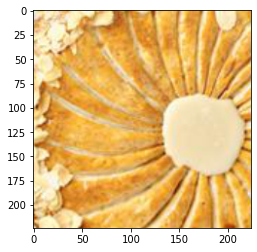

gt:  Soto
predict:  Soto


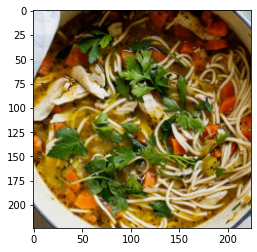

gt:  mazapan
predict:  mazapan


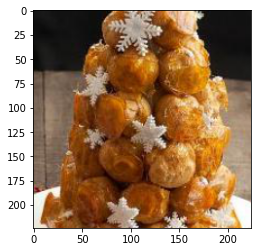

gt:  yogurt
predict:  yogurt


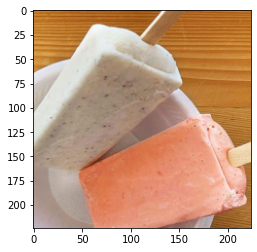

gt:  Frühlingsrollen
predict:  falafel


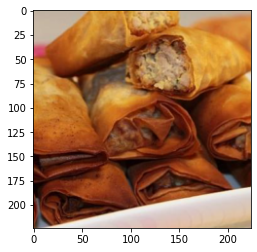

gt:  Cream of Mushroom
predict:  Cream of Mushroom


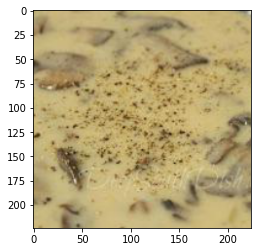

gt:  Frühlingsrollen
predict:  Frühlingsrollen


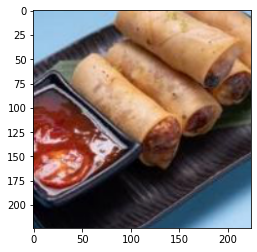

gt:  Oatmeal
predict:  Oatmeal


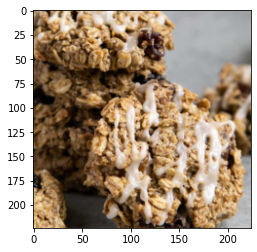

gt:  Bio Samosas
predict:  Bio Samosas


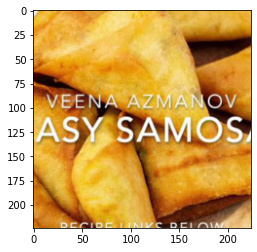

gt:  Soto
predict:  Soto


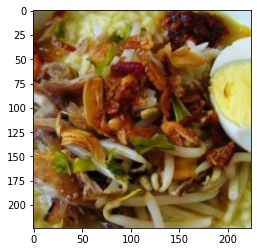

gt:  Kruiden
predict:  falafel


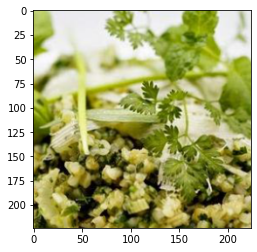

gt:  fried noodle
predict:  Bio Samosas


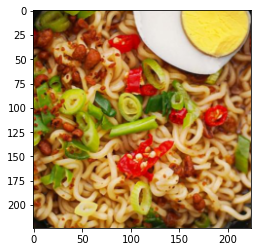

gt:  Sorbete
predict:  Sorbete


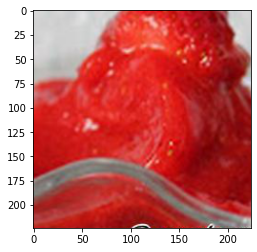

gt:  falafel
predict:  falafel


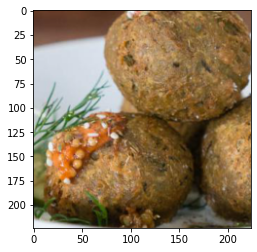

gt:  Heidelbeeren 
predict:  Heidelbeeren 


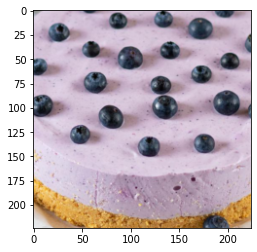

gt:  Frühlingsrollen
predict:  Frühlingsrollen


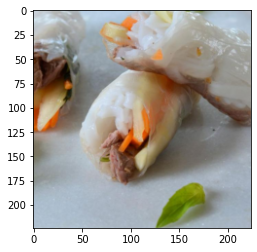

gt:  Frühlingsrollen
predict:  mazapan


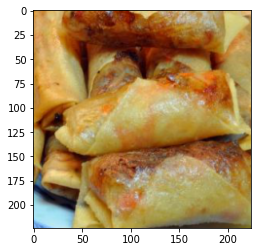

gt:  Heidelbeeren 
predict:  mazapan


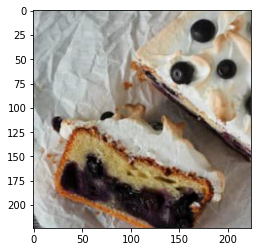

gt:  yogurt
predict:  yogurt


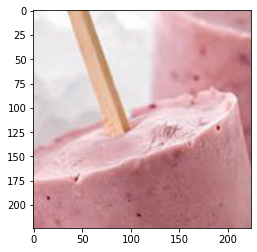

gt:  Frühlingsrollen
predict:  falafel


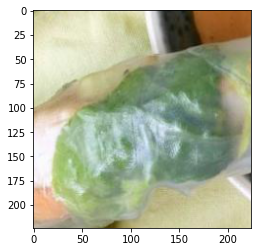

gt:  falafel
predict:  fried noodle


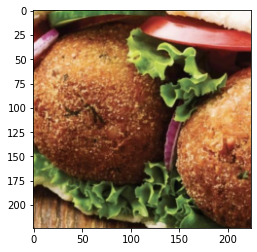

gt:  fried noodle
predict:  fried noodle


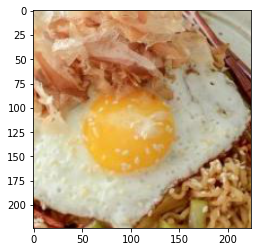

gt:  Soto
predict:  Soto


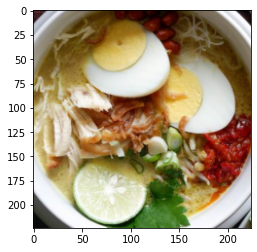

gt:  Soto
predict:  Soto


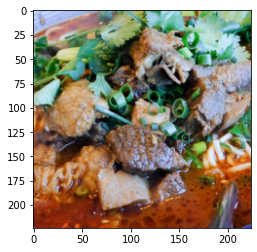

gt:  Frühlingsrollen
predict:  falafel


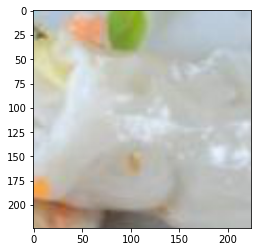

gt:  Soto
predict:  galette


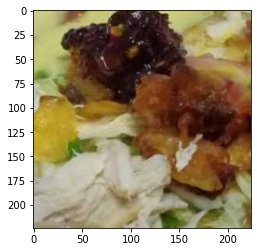

gt:  Heidelbeeren 
predict:  Heidelbeeren 


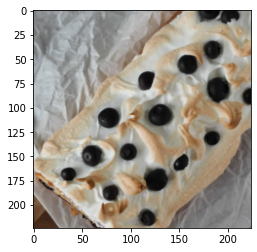

gt:  Frühlingsrollen
predict:  Aceite de Oliva virgen extra


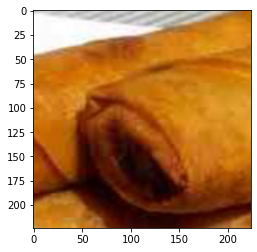

gt:  Oatmeal
predict:  Oatmeal


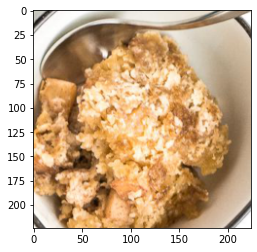

gt:  Soto
predict:  Soto


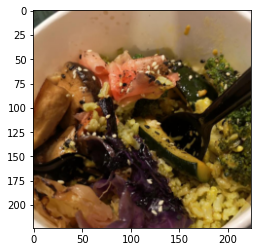

gt:  Shrimp, Soto, Red Dragon, Brown Rice
predict:  Shrimp, Soto, Red Dragon, Brown Rice


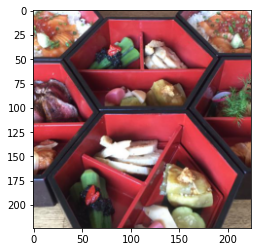

gt:  Cream of Mushroom
predict:  Cream of Mushroom


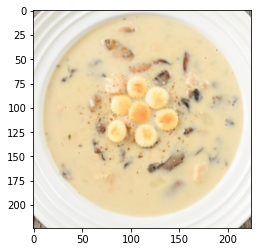

gt:  Cream of Mushroom
predict:  Cream of Mushroom


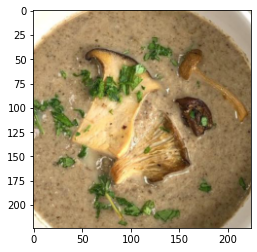

gt:  yogurt
predict:  yogurt


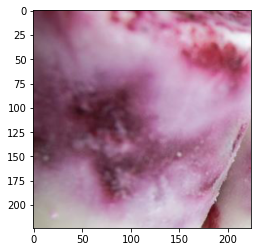

gt:  yogurt
predict:  yogurt


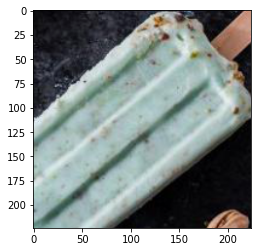

gt:  Frühlingsrollen
predict:  Oatmeal


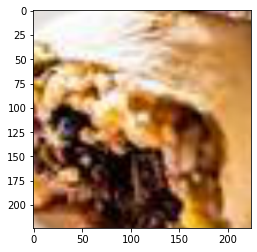

gt:  fried noodle
predict:  fried noodle


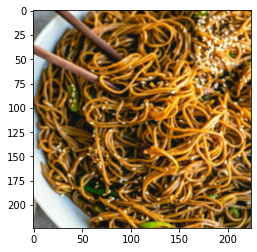

gt:  Aceite de Oliva virgen extra
predict:  Bio Samosas


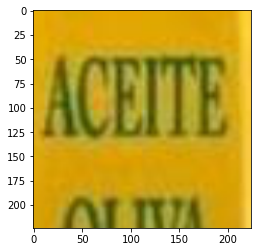

gt:  Soto
predict:  Soto


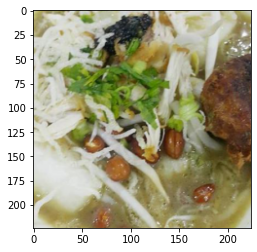

gt:  burger
predict:  burger


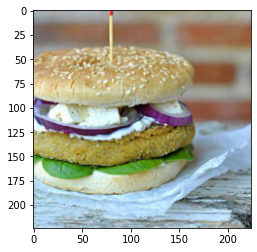

gt:  Nuggets
predict:  Nuggets


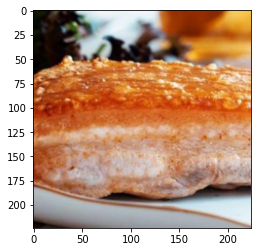

gt:  Frühlingsrollen
predict:  mazapan


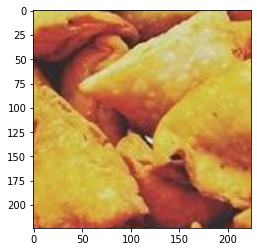

gt:  falafel
predict:  falafel


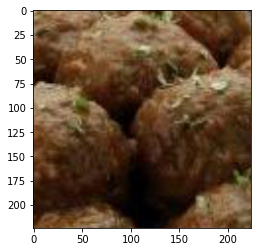

gt:  Polpettine Vegetariane Alla Mediterranea
predict:  mazapan


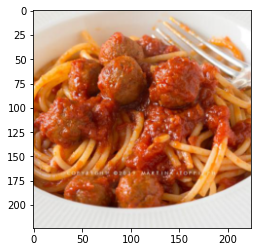

gt:  Aceite de Oliva virgen extra
predict:  Aceite de Oliva virgen extra


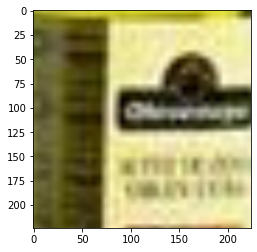

gt:  falafel
predict:  falafel


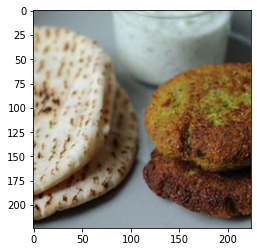

gt:  Aceite de Oliva virgen extra
predict:  Aceite de Oliva virgen extra


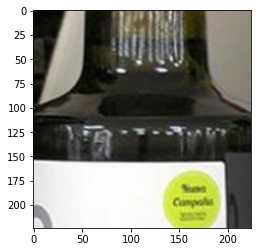

gt:  Frühlingsrollen
predict:  Soto


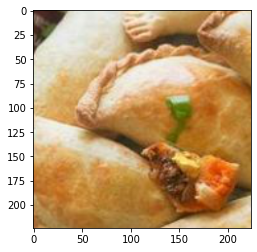

gt:  yogurt
predict:  yogurt


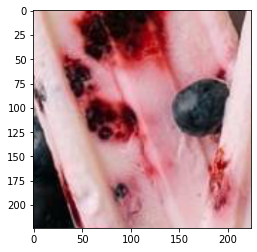

gt:  mazapan
predict:  mazapan


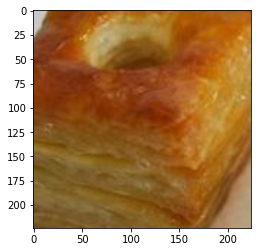

gt:  galette
predict:  Soto


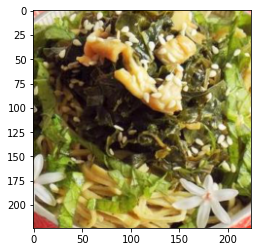

gt:  falafel
predict:  falafel


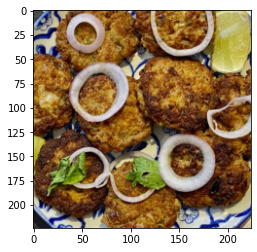

gt:  mazapan
predict:  mazapan


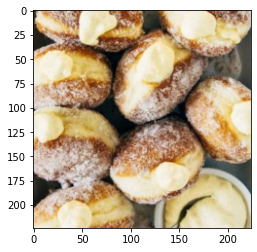

gt:  Frühlingsrollen
predict:  galette


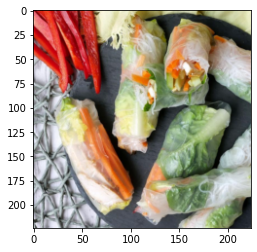

gt:  Aceite de Oliva virgen extra
predict:  Aceite de Oliva virgen extra


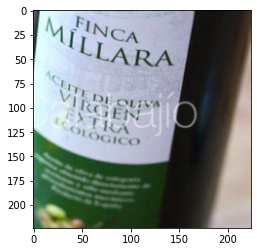

gt:  Frühlingsrollen
predict:  Soto


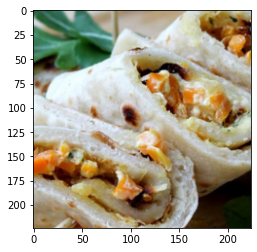

gt:  mazapan
predict:  Aceite de Oliva virgen extra


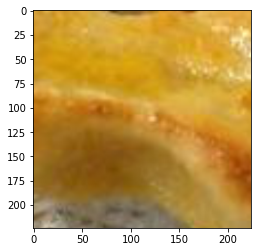

gt:  Soto
predict:  fried noodle


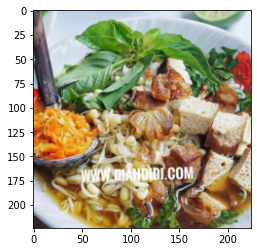

gt:  Soto
predict:  Soto


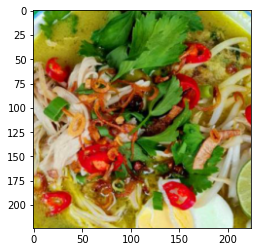

gt:  mazapan
predict:  Bio Samosas


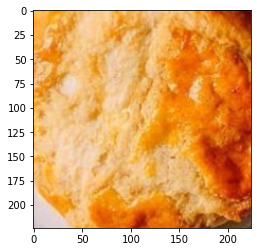

gt:  Heidelbeeren 
predict:  Heidelbeeren 


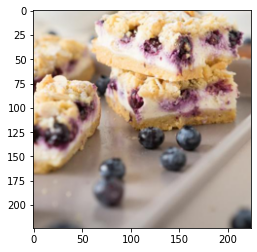

gt:  fried noodle
predict:  fried noodle


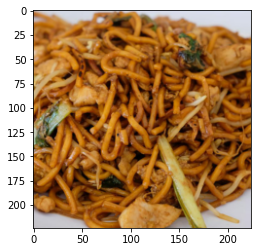

gt:  Oatmeal
predict:  Bio Samosas


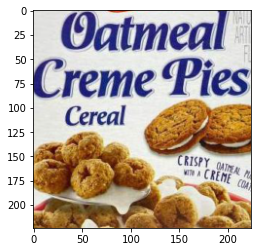

gt:  Soto
predict:  Soto


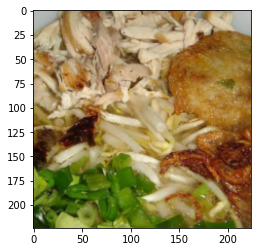

gt:  Soto
predict:  falafel


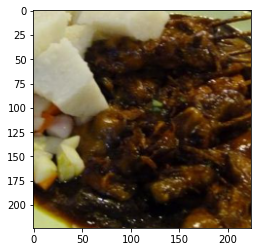

gt:  Frühlingsrollen
predict:  Frühlingsrollen


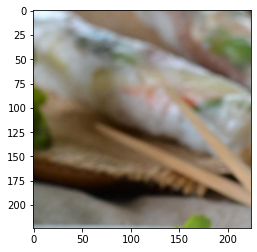

gt:  Soto
predict:  Soto


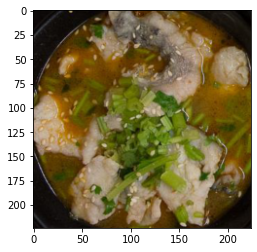

gt:  Soto
predict:  Soto


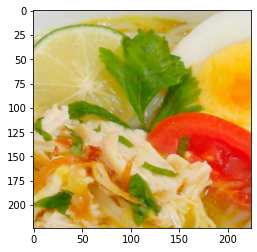

gt:  Frühlingsrollen
predict:  Sorbete


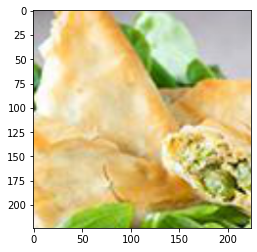

gt:  Frühlingsrollen
predict:  Frühlingsrollen


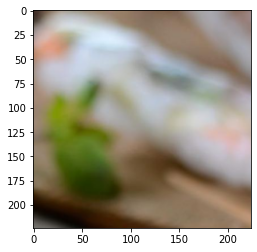

gt:  Soto
predict:  Soto


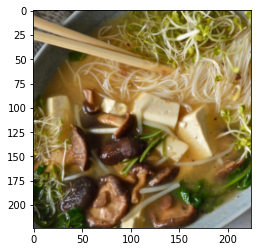

gt:  Oatmeal
predict:  mazapan


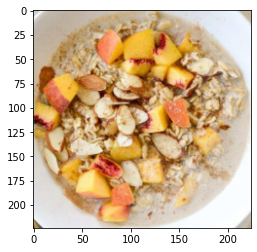

gt:  Soto
predict:  Soto


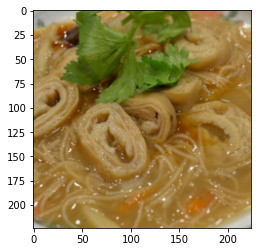

gt:  Soto
predict:  Soto


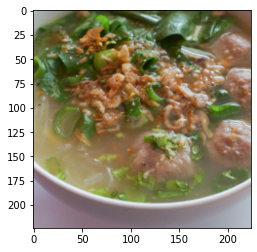

gt:  fried noodle
predict:  fried noodle


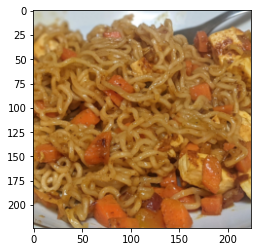

gt:  Frühlingsrollen
predict:  yogurt


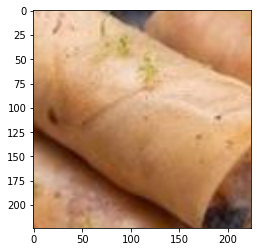

gt:  Soto
predict:  Soto


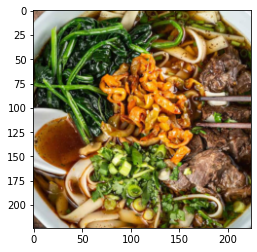

gt:  fried noodle
predict:  fried noodle


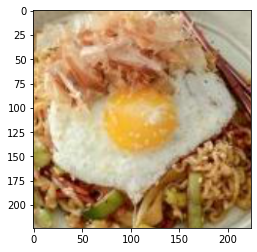

gt:  Frühlingsrollen
predict:  Sorbete


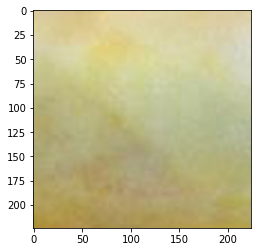

gt:  Soto
predict:  Soto


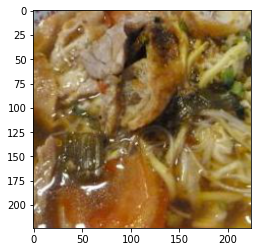

In [ ]:
model.eval()  # it-disables-dropout
with torch.no_grad():
    for idx,(data,label) in enumerate(dataloader['valid']):

      z = data.squeeze(0)
      z = z * torch.tensor(mean).view(3, 1, 1)
      z = z + torch.tensor(std).view(3, 1, 1)

      img = transforms.ToPILImage(mode='RGB')(z)
      data = data.to(device)
      label = label.to(device)
      res = model(data)
      _,res = torch.max(res,1)
      # if int(label[0]) == int(res[0]):
      print('gt: ',df.loc[df['label']==int(label[0])]['label_name'].values[0])
      print('predict: ',df.loc[df['label']==int(res[0])]['label_name'].values[0])

      plt.imshow(img)
      plt.show()
      
      

In [ ]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 9008, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 9008 (delta 19), reused 24 (delta 9), pack-reused 8965
Receiving objects: 100% (9008/9008), 9.44 MiB | 25.30 MiB/s, done.
Resolving deltas: 100% (6265/6265), done.
/content/yolov5
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [ ]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 636 kB 12.4 MB/s 
Setup complete. Using torch 1.9.0+cu102 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights "/content/drive/MyDrive/food project/Quyền/result_yolo/600/best.pt" \
                  --img 416 \
                  --conf 0.29 \
                  --source "/content/test"